# VANILA AUTOENCODER

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Flatten, Reshape
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.metrics import binary_accuracy


In [ ]:
from keras.datasets import mnist
(x_train,y_train),(x_test,y_test) = mnist.load_data()
# to get the shape of the data
print("x_train shape:",x_train.shape)
print("x_test shape", x_test.shape)

x_train shape: (60000, 28, 28)
x_test shape (10000, 28, 28)


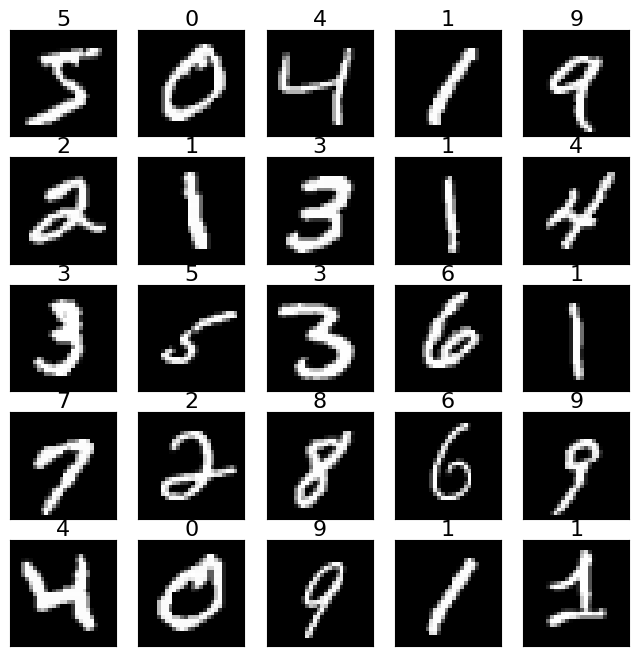

In [ ]:
plt.figure(figsize=(8, 8))
for i in range(25):
    plt.subplot(5, 5, i + 1)
    plt.title(str(y_train[i]), fontsize=16, color='black', pad=2)
    plt.imshow(x_train[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])

plt.show()

In [ ]:
# Define the size of the encoded representation
encoding_dim = 64

# Input placeholder
input_img = Input(shape=(28, 28, 1))

# Encoder
x = Flatten()(input_img)  # Flatten the input image (28 * 28 * 1 = 784)
x = Dense(512, activation='relu')(x)  # First encoder layer (reducing from 784 to 512)
x = Dense(256, activation='relu')(x)  # Second encoder layer (reducing from 512 to 256)
encoded = Dense(encoding_dim, activation='relu')(x)  # Bottleneck layer (reducing from 256 to 64)


# Decoder
x = Dense(256, activation='relu')(encoded)  # First decoder layer (increasing from 64 to 256)
x = Dense(512, activation='relu')(x)  # Second decoder layer (increasing from 256 to 512)
x = Dense(28 * 28, activation='sigmoid')(x)  # Third decoder layer (increasing from 512 to 784)
decoded = Reshape((28, 28, 1))(x)  # Reshape to original image dimensions (784 to 28x28x1)
# Autoencoder model
autoencoder = Model(input_img, decoded)

In [ ]:
# Compile the model with binary crossentropy loss and binary accuracy
autoencoder.compile(optimizer=Adam(), loss=BinaryCrossentropy(), metrics=[binary_accuracy])

In [ ]:
# Train the autoencoder
history = autoencoder.fit(x_train, x_train,
                          epochs=10,
                          batch_size=256,
                          shuffle=True,
                          validation_data=(x_test, x_test))

Epoch 1/10
235/235 [==============================] - 3s 6ms/step - loss: -483.5836 - binary_accuracy: 0.3268 - val_loss: -495.9243 - val_binary_accuracy: 0.3265
Epoch 2/10
235/235 [==============================] - 1s 5ms/step - loss: -490.9306 - binary_accuracy: 0.3261 - val_loss: -499.8860 - val_binary_accuracy: 0.3259
Epoch 3/10
235/235 [==============================] - 1s 5ms/step - loss: -492.6645 - binary_accuracy: 0.3259 - val_loss: -499.8860 - val_binary_accuracy: 0.3259
Epoch 4/10
235/235 [==============================] - 1s 5ms/step - loss: -492.6644 - binary_accuracy: 0.3259 - val_loss: -499.8860 - val_binary_accuracy: 0.3259
Epoch 5/10
235/235 [==============================] - 1s 5ms/step - loss: -492.6644 - binary_accuracy: 0.3259 - val_loss: -499.8860 - val_binary_accuracy: 0.3259
Epoch 6/10
235/235 [==============================] - 1s 5ms/step - loss: -492.6643 - binary_accuracy: 0.3259 - val_loss: -499.8860 - val_binary_accuracy: 0.3259
Epoch 7/10
235/235 [========

In [ ]:
# Evaluate the model
loss, accuracy = autoencoder.evaluate(x_test, x_test)
print(f" Loss: {loss}")
print(f" Accuracy: {accuracy}")

313/313 [==============================] - 1s 2ms/step - loss: -499.8861 - binary_accuracy: 0.3259
 Loss: -499.8861389160156
 Accuracy: 0.3259231150150299


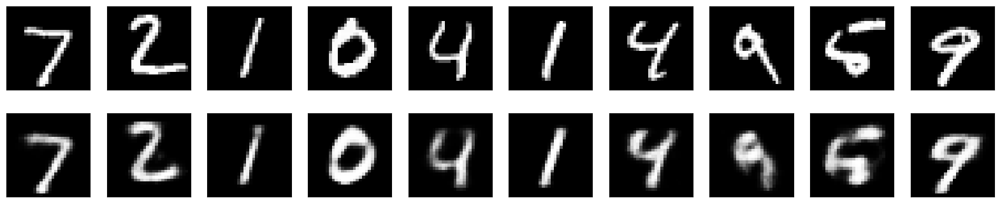

In [ ]:
# Plot the original and reconstructed images
n = 10  # Number of digits to display
plt.figure(figsize=(20, 4))
for i in range(n):
    # Display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i].reshape(28, 28), cmap='gray')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # Display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i].reshape(28, 28), cmap='gray')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

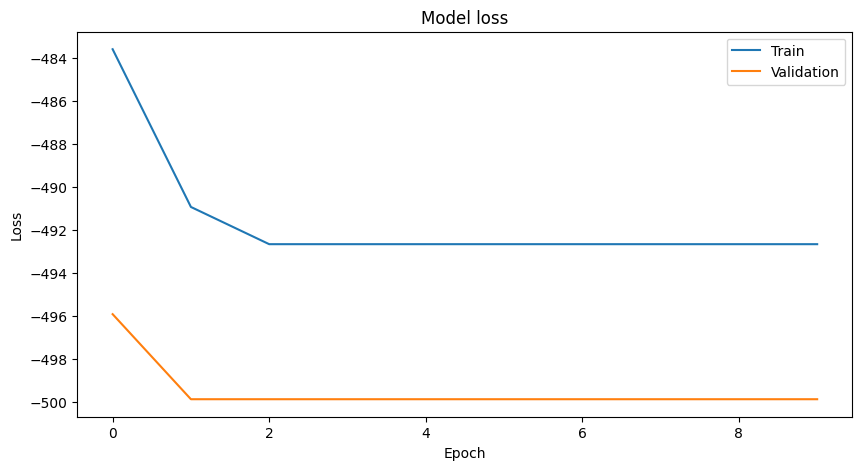

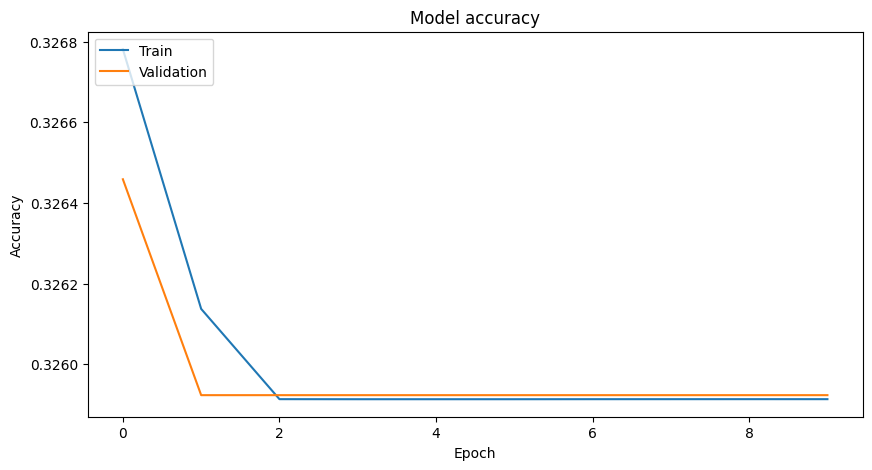

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

# Plot training & validation accuracy values
plt.figure(figsize=(10, 5))
plt.plot(history.history['binary_accuracy'])
plt.plot(history.history['val_binary_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

#Denoising autoencoder


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Conv2D,MaxPool2D, UpSampling2D,Dropout

In [ ]:
from keras.datasets import mnist
(x_train,y_train),(x_test,y_test) = mnist.load_data()
# to get the shape of the data
print("x_train shape:",x_train.shape)
print("x_test shape", x_test.shape)

11490434/11490434 [==============================] - 2s 0us/step
x_train shape: (60000, 28, 28)
x_test shape (10000, 28, 28)


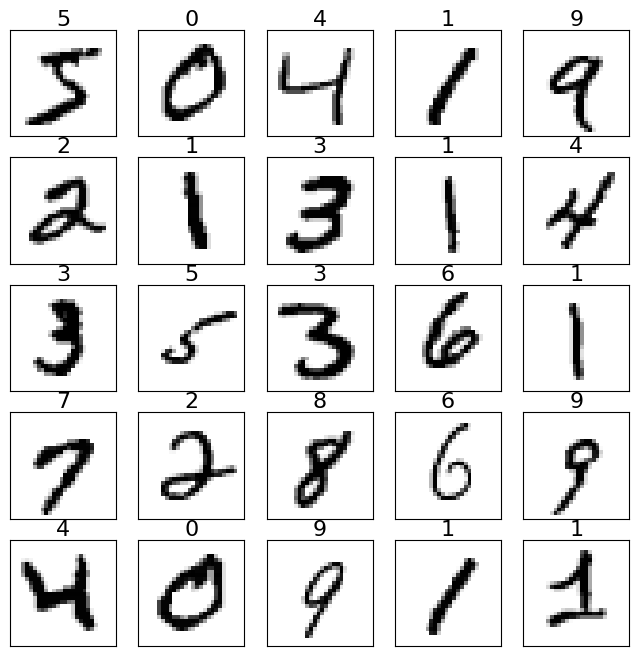

In [ ]:
plt.figure(figsize = (8,8))
for i in range(25):
  plt.subplot(5,5,i+1)
  plt.title(str(y_train[i]),fontsize = 16, color = 'black', pad = 2)
  plt.imshow(x_train[i], cmap = plt.cm.binary )
  plt.xticks([])
  plt.yticks([])

plt.show()

In [ ]:
val_images = x_test[:9000]
test_images = x_test[9000:]

In [ ]:
val_images = val_images.astype('float32') / 255.0
val_images = np.reshape(val_images,(val_images.shape[0],28,28,1))

test_images = test_images.astype('float32') / 255.0
test_images = np.reshape(test_images,(test_images.shape[0],28,28,1))

train_images = x_train.astype("float32") / 255.0
train_images = np.reshape(train_images, (train_images.shape[0],28,28,1))

In [ ]:
factor = 0.39
train_noisy_images = train_images + factor * np.random.normal(loc = 0.0,scale = 1.0,size = train_images.shape)
val_noisy_images = val_images + factor * np.random.normal(loc = 0.0,scale = 1.0,size = val_images.shape)
test_noisy_images = test_images + factor * np.random.normal(loc = 0.0,scale = 1.0,size = test_images.shape)

# here maximum pixel value for our images may exceed 1 so we have to clip the images
train_noisy_images = np.clip(train_noisy_images,0.,1.)
val_noisy_images = np.clip(val_noisy_images,0.,1.)
test_noisy_images = np.clip(test_noisy_images,0.,1.)

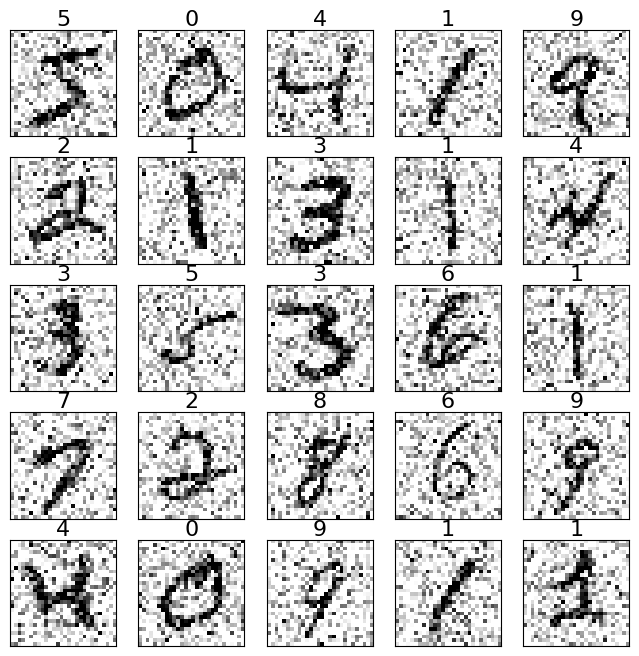

In [ ]:
plt.figure(figsize = (8,8))

for i in range(25):
      plt.subplot(5,5,i+1)
      plt.title(str(y_train[i]),fontsize = 16, color = 'black', pad = 2)
      plt.imshow(train_noisy_images[i].reshape(1,28,28)[0], cmap = plt.cm.binary )
      plt.xticks([])
      plt.yticks([])

plt.show()

In [ ]:
model = Sequential()
# encoder network
model.add(Conv2D(filters = 128, kernel_size = (2,2), activation = 'relu', padding = 'same', input_shape = (28,28,1)))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 128, kernel_size = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 256, kernel_size = (2,2),strides = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 256, kernel_size = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 512, kernel_size = (3,3), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 512, kernel_size = (2,2),strides = (2,2), activation = 'relu', padding = 'same'))



# decoder network
model.add(Conv2D(filters = 512, kernel_size = (2,2), activation = 'relu', padding = 'same'))

model.add(tf.keras.layers.Conv2DTranspose(filters = 512, kernel_size = (2,2), strides = (2,2),activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 256, kernel_size = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 256, kernel_size = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(Conv2D(filters = 128, kernel_size = (2,2), activation = 'relu', padding = 'same'))


model.add(tf.keras.layers.Conv2DTranspose(filters = 128, kernel_size = (2,2),strides = (2,2), activation = 'relu', padding = 'same'))
model.add(Conv2D(filters = 64, kernel_size = (2,2), activation = 'relu', padding = 'same'))
model.add(tf.keras.layers.BatchNormalization())

model.add(Conv2D(filters = 1, kernel_size = (2,2), activation = 'relu', padding = 'same'))


# to get the summary of the model
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 128)       640       
                                                                 
 batch_normalization (Batch  (None, 28, 28, 128)       512       
 Normalization)                                                  
                                                                 
 conv2d_1 (Conv2D)           (None, 28, 28, 128)       65664     
                                                                 
 batch_normalization_1 (Bat  (None, 28, 28, 128)       512       
 chNormalization)                                                
                                                                 
 conv2d_2 (Conv2D)           (None, 14, 14, 256)       131328    
                                                                 
 batch_normalization_2 (Bat  (None, 14, 14, 256)       1

In [ ]:
OPTIMIZER =  tf.keras.optimizers.Adam(learning_rate = 0.001)
LOSS = 'mean_squared_error'
model.compile(optimizer =OPTIMIZER, loss = LOSS, metrics = ['accuracy'])

In [ ]:
EPOCHS = 5
BATCH_SIZE = 128
VALIDATION = (val_noisy_images, val_images)
history = model.fit(train_noisy_images, train_images,batch_size = BATCH_SIZE,epochs = EPOCHS, validation_data = VALIDATION)

Epoch 1/5
469/469 [==============================] - 114s 202ms/step - loss: 0.0357 - accuracy: 0.8084 - val_loss: 0.0437 - val_accuracy: 0.8118
Epoch 2/5
469/469 [==============================] - 92s 196ms/step - loss: 0.0085 - accuracy: 0.8144 - val_loss: 0.0079 - val_accuracy: 0.8143
Epoch 3/5
469/469 [==============================] - 91s 194ms/step - loss: 0.0077 - accuracy: 0.8146 - val_loss: 0.0076 - val_accuracy: 0.8143
Epoch 4/5
469/469 [==============================] - 92s 197ms/step - loss: 0.0073 - accuracy: 0.8147 - val_loss: 0.0072 - val_accuracy: 0.8143
Epoch 5/5
469/469 [==============================] - 91s 194ms/step - loss: 0.0070 - accuracy: 0.8147 - val_loss: 0.0086 - val_accuracy: 0.8138


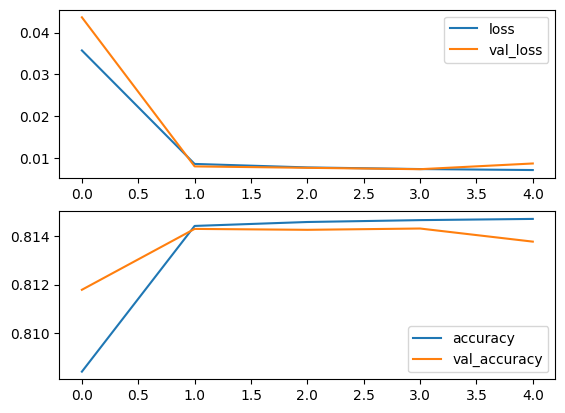

In [ ]:
plt.subplot(2,1,1)
plt.plot( history.history['loss'], label = 'loss')
plt.plot( history.history['val_loss'], label = 'val_loss')
plt.legend(loc = 'best')
plt.subplot(2,1,2)
plt.plot( history.history['accuracy'], label = 'accuracy')
plt.plot( history.history['val_accuracy'], label = 'val_accuracy')
plt.legend(loc = 'best')
plt.show()

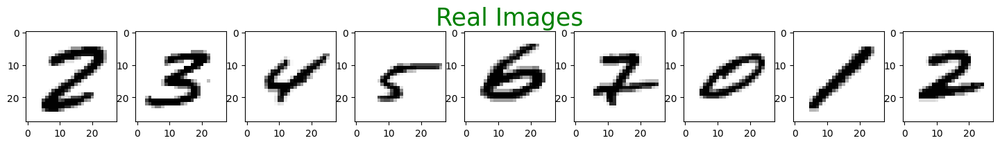

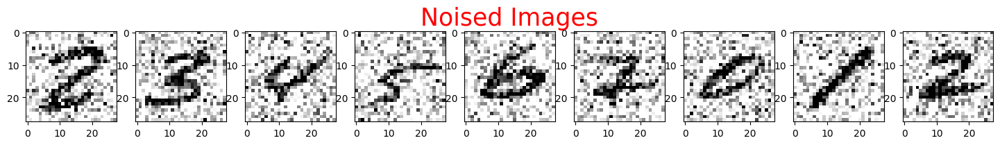

1/1 [==============================] - 0s 17ms/step


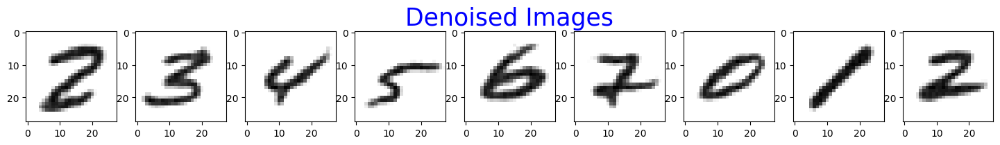

In [ ]:
plt.figure(figsize = (18,18))
for i in range(10,19):
    plt.subplot(9,9,i)
    if(i == 14):
        plt.title('Real Images', fontsize = 25, color = 'Green')
    plt.imshow(test_images[i].reshape(1,28,28)[0], cmap = plt.cm.binary)
plt.show()


plt.figure(figsize = (18,18))
for i in range(10,19):
    if(i == 15):
        plt.title('Noised Images', fontsize = 25, color = 'red')
    plt.subplot(9,9,i)
    plt.imshow(test_noisy_images[i].reshape(1,28,28)[0], cmap = plt.cm.binary)
plt.show()


plt.figure(figsize = (18,18))
for i in range(10,19):
    if(i == 15):
        plt.title('Denoised Images', fontsize = 25, color = 'Blue')

    plt.subplot(9,9,i)
    plt.imshow(model.predict(test_noisy_images[i].reshape(1,28,28,1)).reshape(1,28,28)[0], cmap = plt.cm.binary)
plt.show()

#GANS GENERATE FACES

In [ ]:
%%capture
!pip intall torchsummary
!pip install torch-snippets

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as T
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, Dataset
from torch.optim import Adam
import numpy as np
import matplotlib.pyplot as plt
from torchsummary import summary
from torch_snippets import *
import cv2
from PIL import Image
import torchvision.utils as vutils

In [ ]:
!wget https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip

--2024-05-30 06:14:06--  https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.2.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.2.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /scl/fi/5p6kzl0arres80oibztr0/male_female_face_images.zip?rlkey=l2g4hsm5w4z9p4q6vj42mjyr1 [following]
--2024-05-30 06:14:07--  https://www.dropbox.com/scl/fi/5p6kzl0arres80oibztr0/male_female_face_images.zip?rlkey=l2g4hsm5w4z9p4q6vj42mjyr1
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc83aa3ccc05df4ba83fcd929b97.dl.dropboxusercontent.com/cd/0/inline/CT2dISlHnPHtH9pfeXOaRYooLq7TpMmYhwdRlfDi9-gn4LDMVm-wvcFGM8mBrH_2T4nQxh1dMWeQmZoDtK-xixQKLatAc-tlZFAUD40n7AycSVrFCeS0E1EVc8ugUG2mCJRxfxkYHOqHF0r4SB5m9EcA/file# [following]
--2024-05-30 06:14:07--  https://uc83aa3ccc05df4ba83fcd929b97.dl.dropboxusercon

In [ ]:
!unzip '/content/male_female_face_images.zip' -d '/content/FaceImages'

Streaming output truncated to the last 5000 lines.
  inflating: /content/FaceImages/males/30272.jpg  
  inflating: /content/FaceImages/males/30273.jpg  
  inflating: /content/FaceImages/males/30274.jpg  
  inflating: /content/FaceImages/males/3028.jpg  
  inflating: /content/FaceImages/males/30281.jpg  
  inflating: /content/FaceImages/males/30286.jpg  
  inflating: /content/FaceImages/males/30287.jpg  
  inflating: /content/FaceImages/males/30288.jpg  
  inflating: /content/FaceImages/males/3029.jpg  
  inflating: /content/FaceImages/males/30293.jpg  
  inflating: /content/FaceImages/males/30294.jpg  
  inflating: /content/FaceImages/males/30295.jpg  
  inflating: /content/FaceImages/males/3030.jpg  
  inflating: /content/FaceImages/males/30300.jpg  
  inflating: /content/FaceImages/males/30301.jpg  
  inflating: /content/FaceImages/males/30302.jpg  
  inflating: /content/FaceImages/males/30307.jpg  
  inflating: /content/FaceImages/males/30308.jpg  
  inflating: /content/FaceImages/m

In [ ]:
!mkdir croppedFaces

In [ ]:
images = Glob('/content/FaceImages/females/*.jpg') + Glob('/content/FaceImages/males/*.jpg')

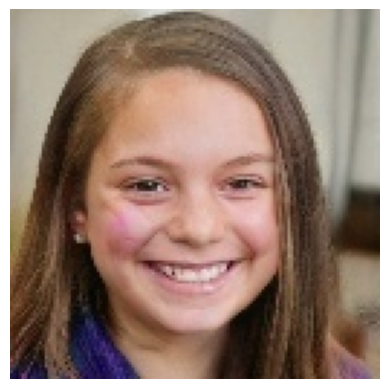

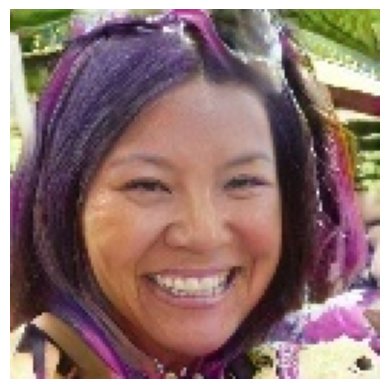

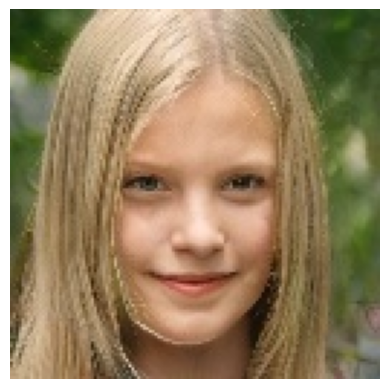

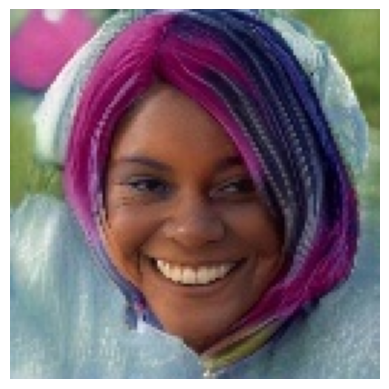

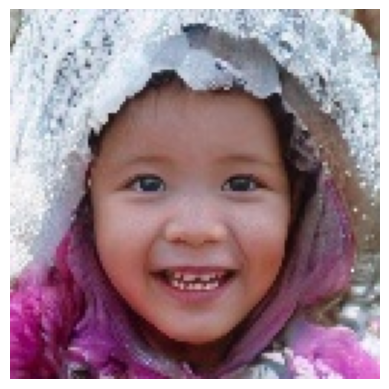

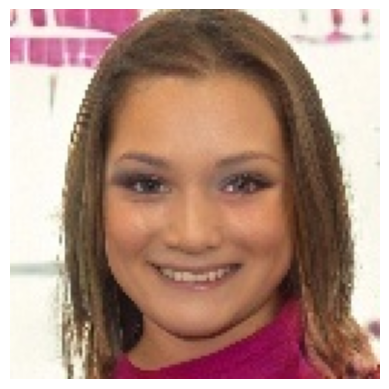

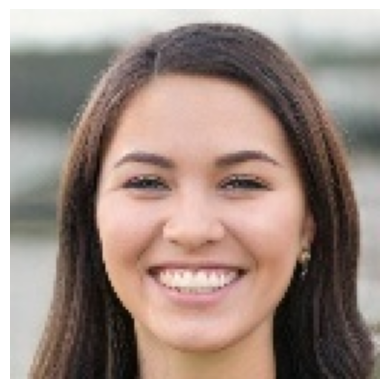

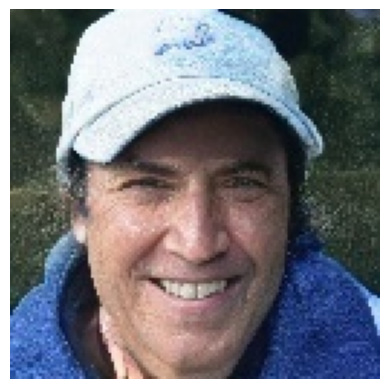

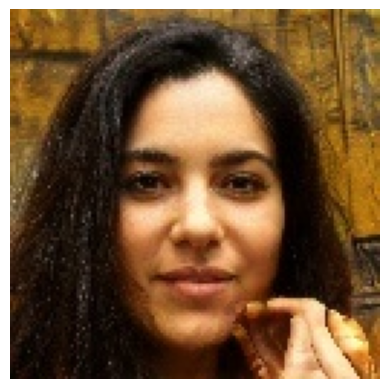

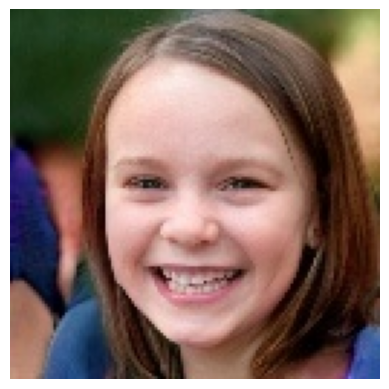

In [ ]:
for i in range(10):
  img = read(images[i],1)
  plt.imshow(img)
  plt.axis('off')
  plt.show()

In [ ]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

In [ ]:
for i in range(len(images)):
  img = read(images[i],1)
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  faces = face_cascade.detectMultiScale(gray, 1.3, 5)
  for x,y,w,h in faces:
    img2 = img[x:(x+w), y:(y+h),:]
  cv2.imwrite('/content/croppedFaces/'+str(i)+'.jpg', cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))

In [ ]:
myTransforms = T.Compose([
    T.Resize(64),
    T.CenterCrop(64),
    T.ToTensor(),
    T.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5))
])

In [ ]:
class Faces(Dataset):
  def __init__(self, folder):
    super().__init__()
    self.folder = folder
    self.images = sorted(Glob(folder))
  def __len__(self):
    return len(self.images)
  def __getitem__(self, index):
    imgPath = self.images[index]
    image = Image.open(imgPath)
    image = myTransforms(image)
    return image

In [ ]:
dataset = Faces('/content/croppedFaces/')
dataLoader = DataLoader(dataset, batch_size=64, shuffle=True, num_workers=2)

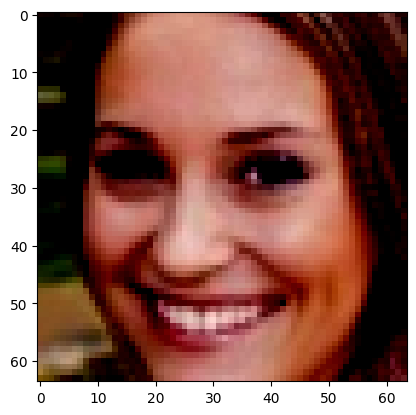

In [ ]:
image = dataset[50]
plt.imshow(image.permute(1,2,0), 'gray')

In [ ]:
dl = iter(dataLoader)
images = next(dl)
len(images)

64

In [ ]:
def weights_init(m):
  className = m.__class__.__name__
  if className.find('Conv') != -1:
    nn.init.normal_(m.weight.data,0.0,0.02).to(device)
  elif className.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02).to(device)
    nn.init.constant_(m.bias, 0).to(device)

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.model = nn.Sequential(
        nn.Conv2d(3,64,4,2, 1, bias=False), # 64,
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(64, 64*2, 4,2,1,bias=False),
        nn.BatchNorm2d(64*2),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(64*2, 64*4, 4,2,1,bias=False),
        nn.BatchNorm2d(64*4),
        nn.LeakyReLU(0.2,inplace=True),
        nn.Conv2d(64*4,64*8, 4, 2, 1, bias=False),
        nn.BatchNorm2d(64*8),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(64*8,1, 4,1,0, bias=False),
        nn.Sigmoid()
    )
    self.apply(weights_init)
  def forward(self, input):
    return self.model(input)


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
discriminator = Discriminator().to(device)

In [ ]:
input = torch.randn(1,3,64,64).to(device)
summary(discriminator, (3,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
Total params: 2,765,568
Trainable param

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()
    self.model = nn.Sequential(
        nn.ConvTranspose2d(100,64*8, 4,1,0, bias=False),
        nn.BatchNorm2d(64*8),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d(64*8,64*4,4,2,1,bias=False),
        nn.BatchNorm2d(64*4),
        nn.ReLU(True),
        nn.ConvTranspose2d(64*4,64*2,4,2,1,bias=False),
        nn.BatchNorm2d(64*2),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d(64*2,64, 4,2,1, bias=False),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        nn.ConvTranspose2d(64,3,4,2,1, bias=False), #64,64
        #224,224
        nn.Tanh()
    )
    self.apply(weights_init)
  def forward(self, input):
    return self.model(input)


In [ ]:
generator = Generator().to(device)

In [ ]:
summary(generator, (100,1,1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

In [ ]:
def discriminatorTrainStep(realData, fakeData):
    disc_optimizer.zero_grad()
    predictionReal = discriminator(realData)
    targetReal = torch.ones_like(predictionReal)
    errorReal = loss(predictionReal.squeeze(), targetReal.squeeze())
    errorReal.backward()

    predictionFake = discriminator(fakeData)
    targetFake = torch.zeros_like(predictionFake)
    errorFake = loss(predictionFake.squeeze(), targetFake.squeeze())
    errorFake.backward()

    disc_optimizer.step()

    return errorReal + errorFake

def generatorTrainStep(fakeData):
  gen_optimizer.zero_grad()
  prediction = discriminator(fakeData)
  error = loss(prediction.squeeze(), torch.ones(len(fakeData)).to(device).squeeze())
  error.backward()
  gen_optimizer.step()

  return error
def GenShow():
  generator.eval()
  noise = torch.randn(64, 100, 1, 1, device=device)
  sample_images = generator(noise).detach().cpu()
  grid = vutils.make_grid(sample_images,nrow=8,normalize=True)
  show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')
  generator.train()



In [ ]:
loss = nn.BCELoss()
disc_optimizer = Adam(discriminator.parameters(), lr=1e-3, betas=(0.5,0.999))
gen_optimizer = Adam(generator.parameters(), lr=1e-3, betas=(0.5, 0.999))

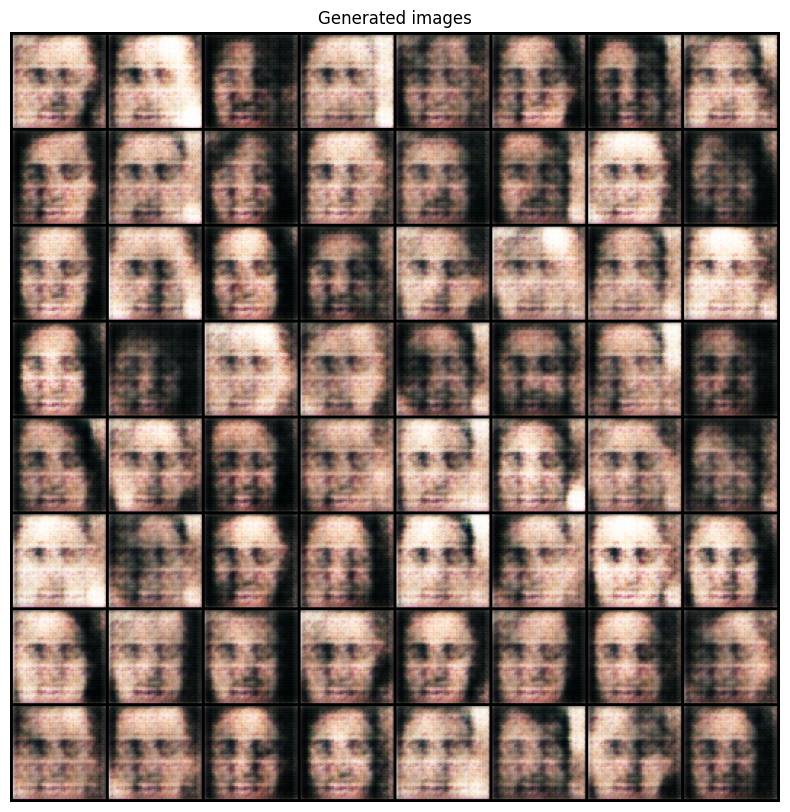

Epoch: [1/10] GenLoss: 1.59 DiscLoss: 0.77


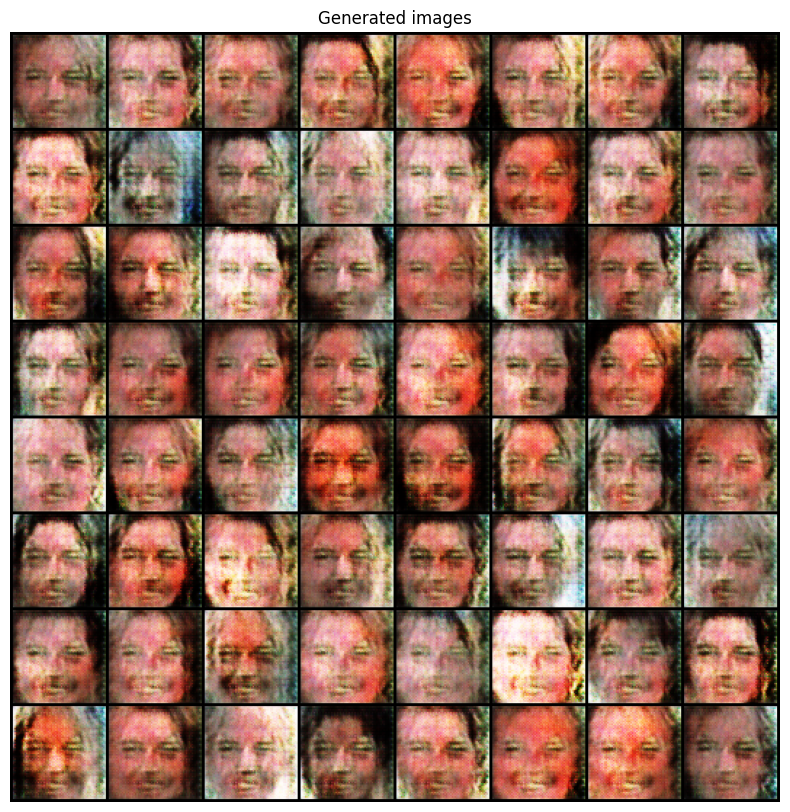

Epoch: [2/10] GenLoss: 3.30 DiscLoss: 1.92


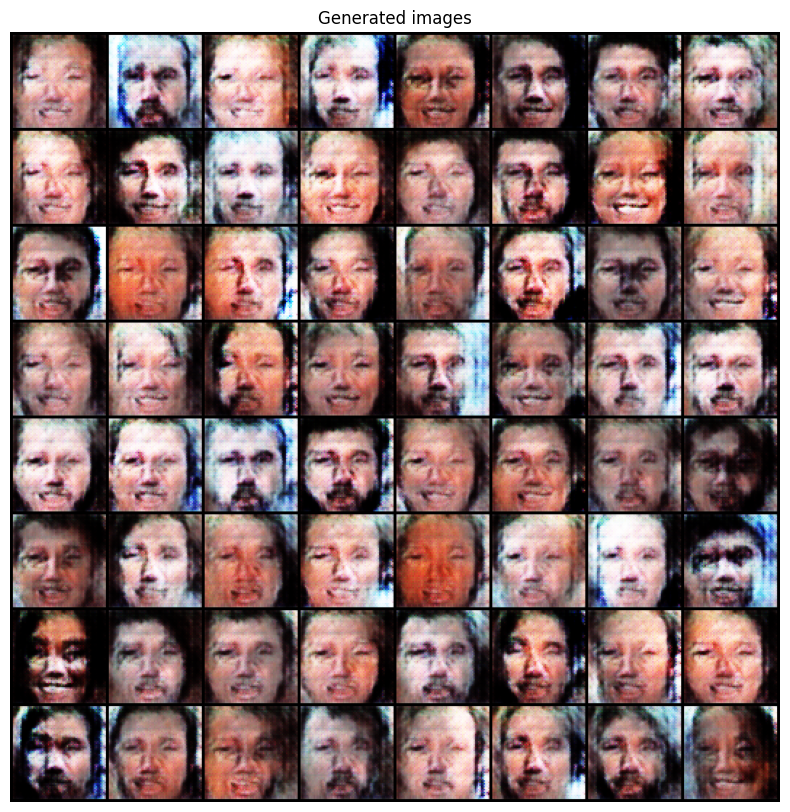

Epoch: [3/10] GenLoss: 1.81 DiscLoss: 0.84


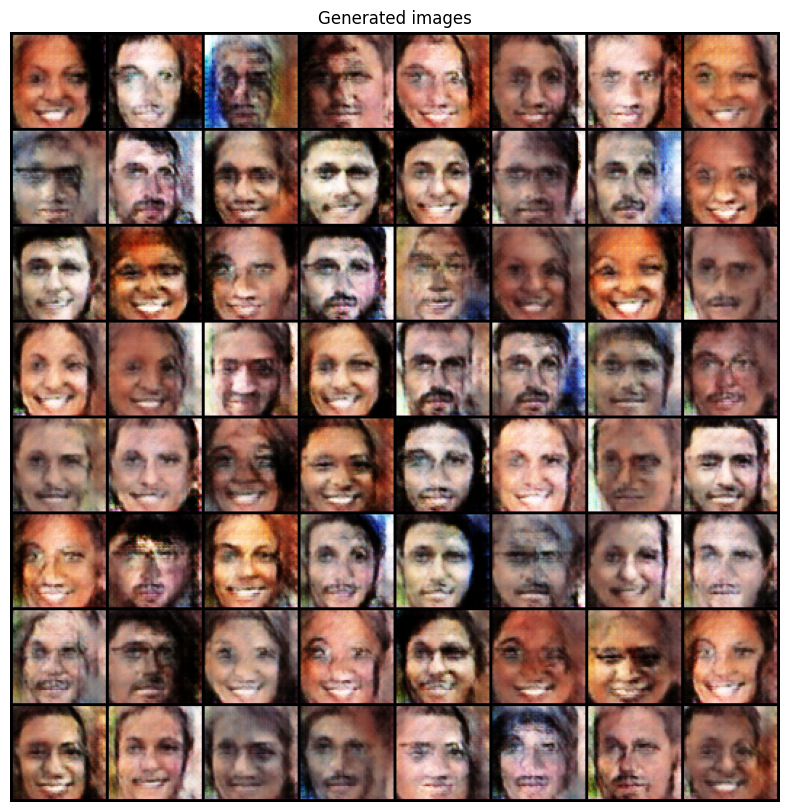

Epoch: [4/10] GenLoss: 4.10 DiscLoss: 1.08


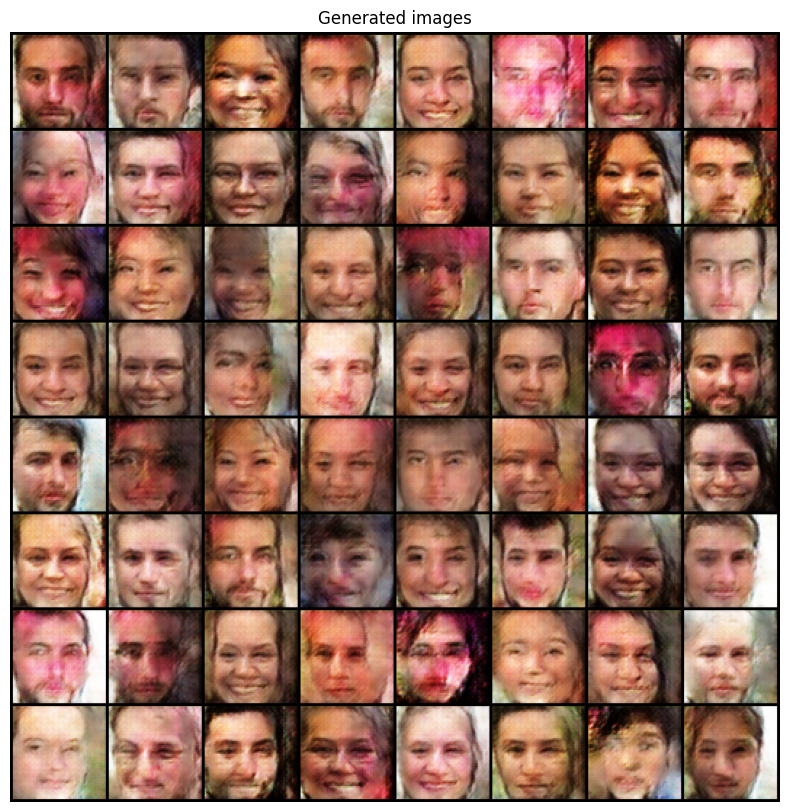

Epoch: [5/10] GenLoss: 1.21 DiscLoss: 1.07


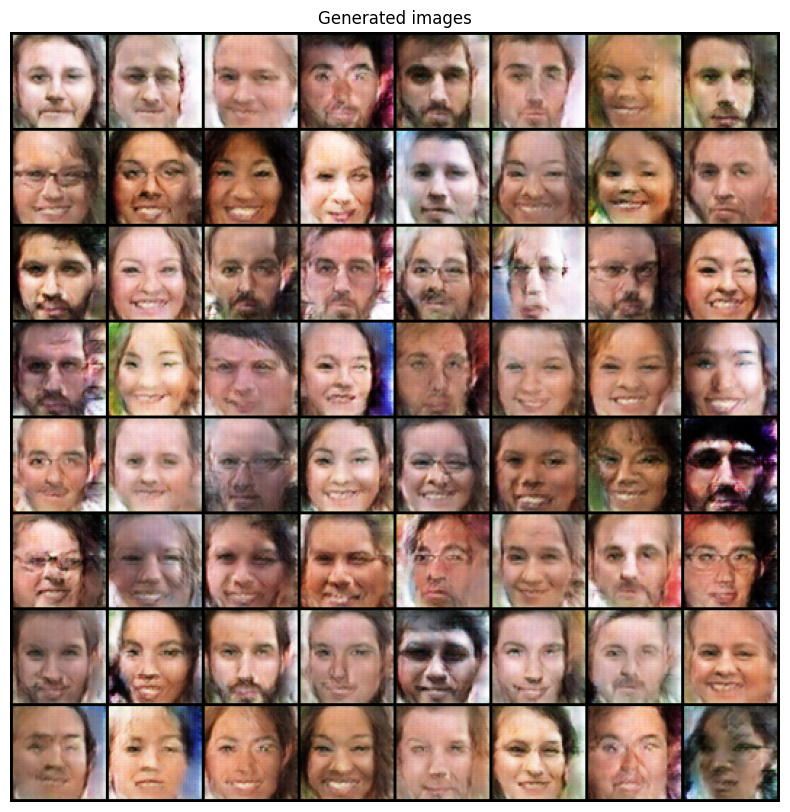

Epoch: [6/10] GenLoss: 2.10 DiscLoss: 1.16


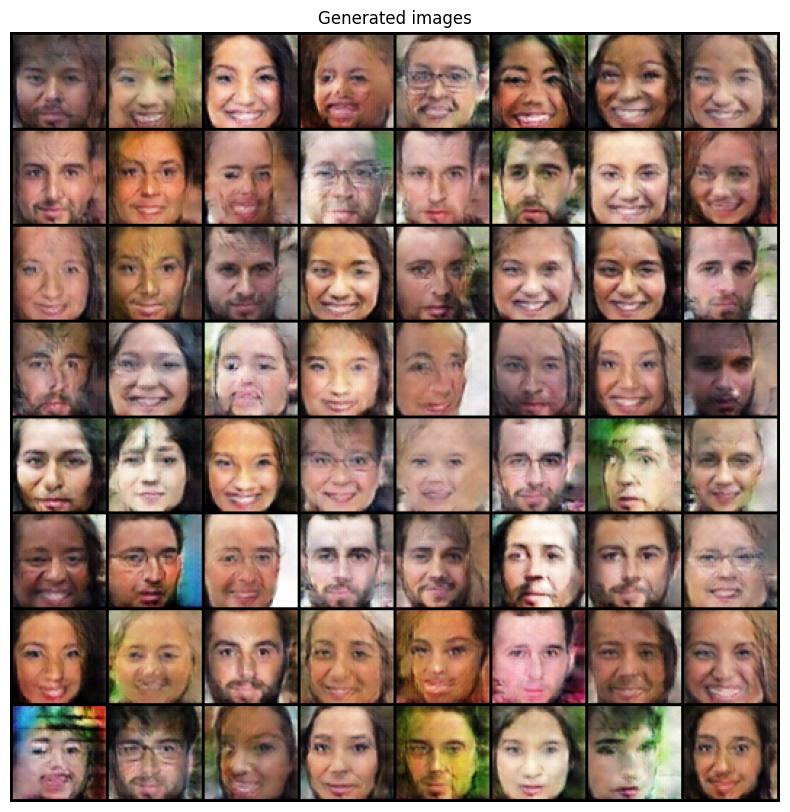

Epoch: [7/10] GenLoss: 2.36 DiscLoss: 0.82


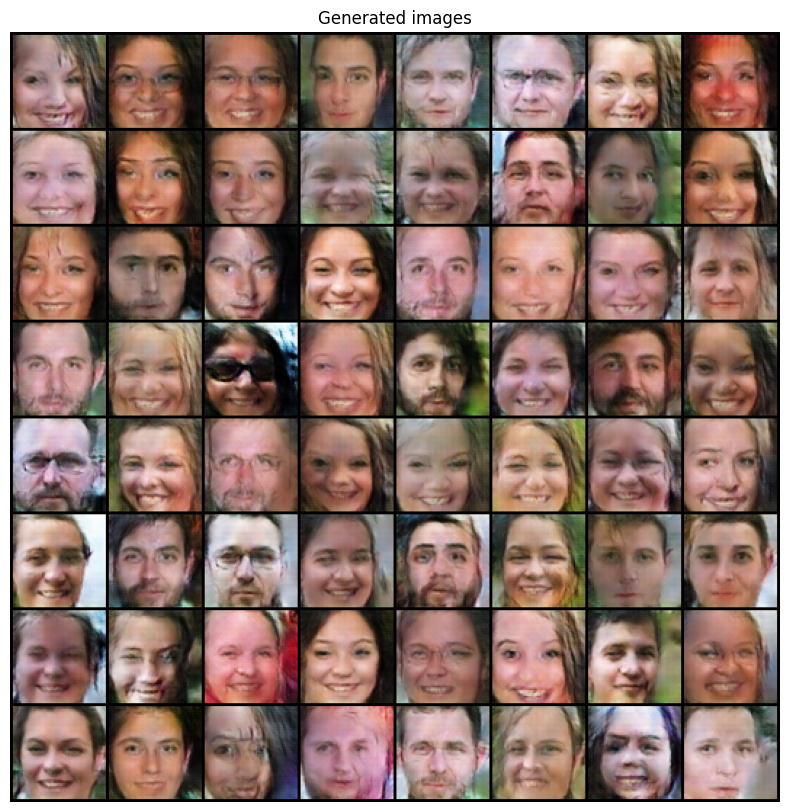

Epoch: [8/10] GenLoss: 1.73 DiscLoss: 1.34


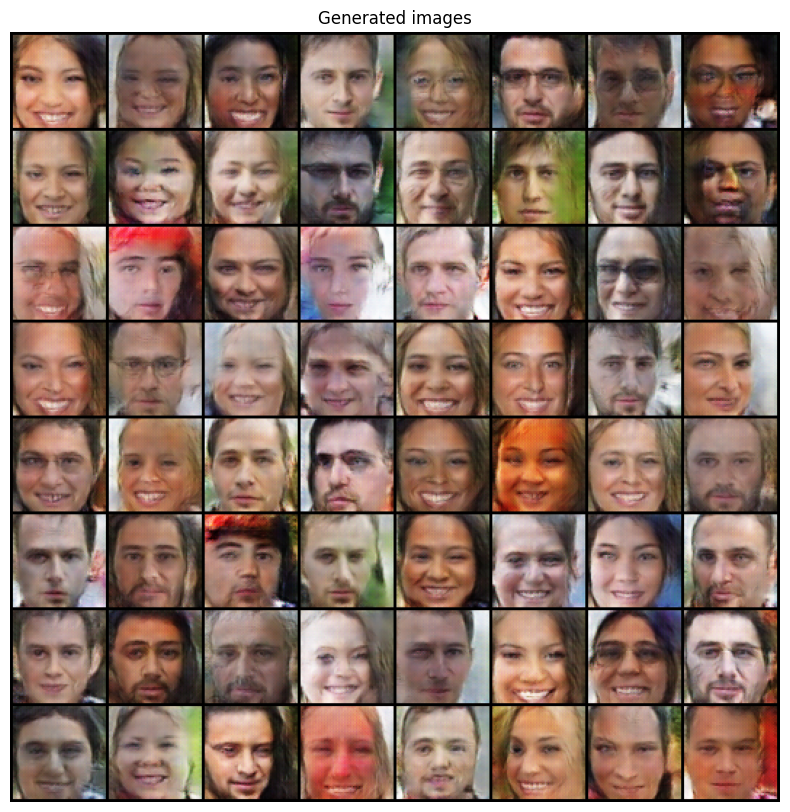

Epoch: [9/10] GenLoss: 1.94 DiscLoss: 0.62


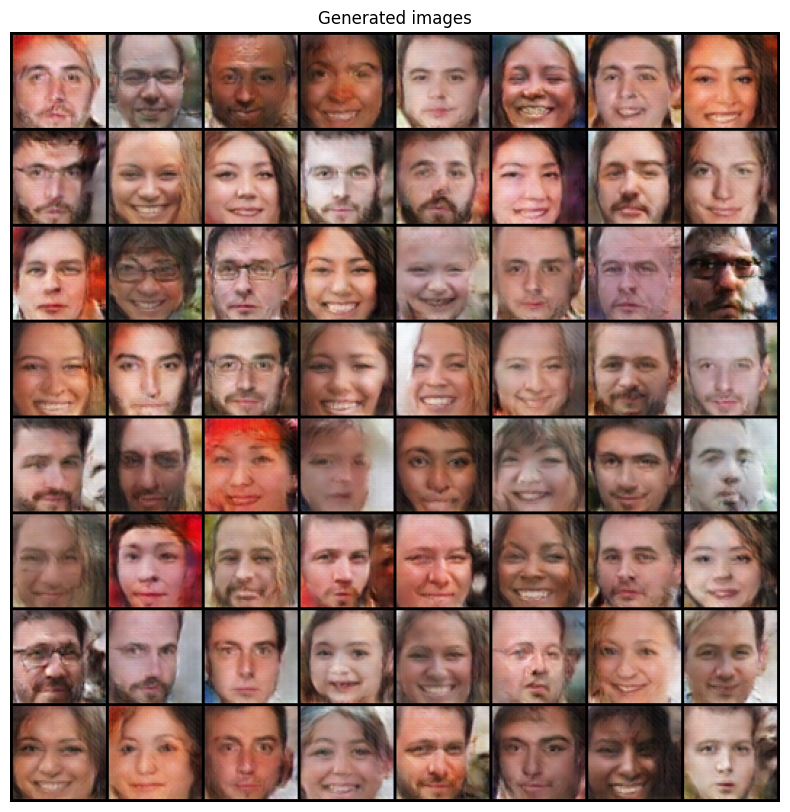

Epoch: [10/10] GenLoss: 4.11 DiscLoss: 1.18


In [ ]:
epochs = 10
for epoch in range(epochs):
  N = len(dataLoader)
  for i, images in enumerate(dataLoader):
    realData = images.to(device)
    fakeData = generator(torch.randn(len(realData), 100,1,1).to(device)).to(device)
    fakeData = fakeData.detach()
    discLoss = discriminatorTrainStep(realData, fakeData)
    fakeData = generator(torch.randn(len(realData), 100,1,1).to(device)).to(device)
    genLoss = generatorTrainStep(fakeData)
  GenShow()
  print(f'Epoch: [{epoch+1}/{epochs}] GenLoss: {genLoss.item():.2f} DiscLoss: {discLoss.item():.2f}')

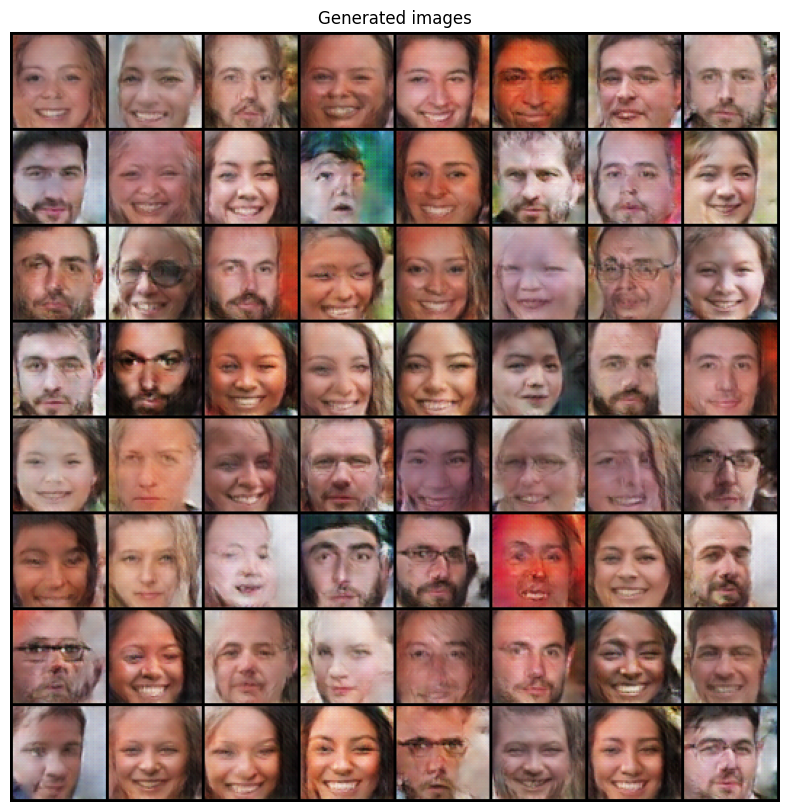

In [ ]:
generator.eval()
noise = torch.randn(64, 100, 1, 1, device=device)
sample_images = generator(noise).detach().cpu()
grid = vutils.make_grid(sample_images,nrow=8,normalize=True)
show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')

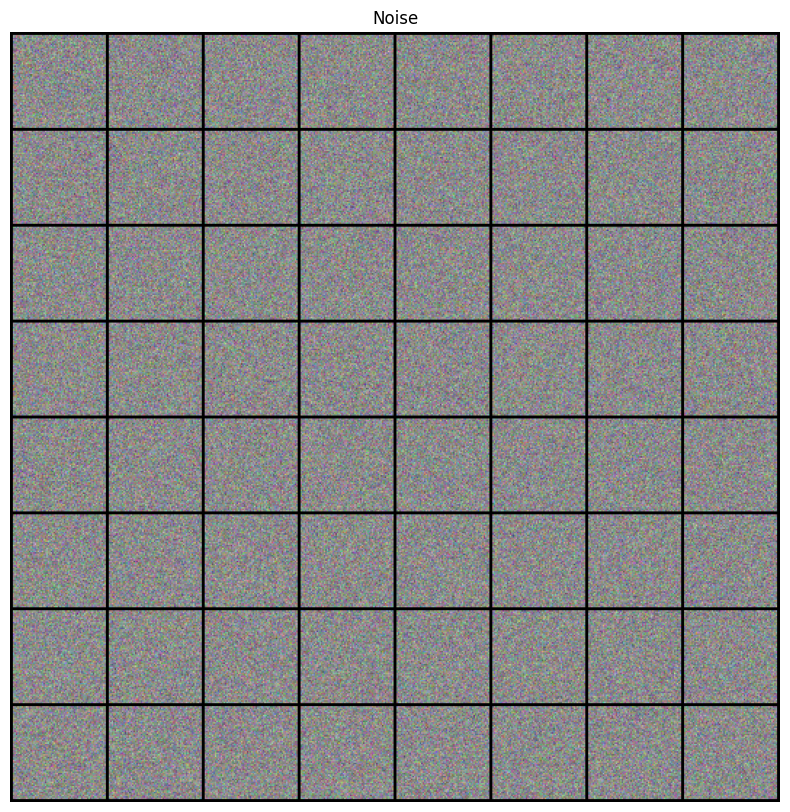

In [ ]:
noise = torch.randn(64, 3,64,64)
grid = vutils.make_grid(noise,nrow=8,normalize=True)
show(grid.cpu().detach().permute(1,2,0), sz=10, title='Noise')

In [ ]:
noise = torch.randn(64, 100, 1, 1, device=device)
noise

tensor([[[[ 0.4571]],

         [[-1.0042]],

         [[-0.5754]],

         ...,

         [[ 1.0231]],

         [[ 0.1887]],

         [[ 1.0183]]],


        [[[-2.4921]],

         [[ 1.1235]],

         [[-0.4204]],

         ...,

         [[ 0.5691]],

         [[-1.7043]],

         [[ 0.1016]]],


        [[[-0.5026]],

         [[ 0.7809]],

         [[-0.9932]],

         ...,

         [[-0.0760]],

         [[ 1.3314]],

         [[-0.6055]]],


        ...,


        [[[-0.5566]],

         [[-1.3980]],

         [[ 0.0843]],

         ...,

         [[ 0.1732]],

         [[-1.0175]],

         [[ 0.1768]]],


        [[[ 1.7026]],

         [[ 0.3515]],

         [[-0.4649]],

         ...,

         [[-0.0825]],

         [[-0.5897]],

         [[-1.6372]]],


        [[[ 0.0441]],

         [[-2.2425]],

         [[ 0.1095]],

         ...,

         [[ 1.6537]],

         [[ 1.8979]],

         [[-0.4523]]]], device='cuda:0')